In [1]:
from vega import VegaLite
from IPython.display import display
import json
import csv

In [1]:
def generate_line(data, features, x="x", y="y", z="z"):
    z=z+"_color"
    lines={
        "width": 500,
        "height": 500,
        "data": {
            "values":data
                },
        "layer":[]
    }
    
    
    for feature in features:
        layer={
        "encoding":
            {
            "x": {"field": x, "type": "quantitative"},
            "y": {"field": y, "type": "quantitative"} 
            },
        "transform":
            [
            {
            "filter":
                    {"field":"feature","equal":feature}
            }
            ],
        "layer":[
            {
            "mark": {"type":"line"},
            "encoding":
                {    
                "color":
                    {
                    "field":z,
                    "type":"quantitative",
                    "scale":
                        {
                        #"domain": [0,10],
                        "range": ["orange", "red", "violet", "bleu"]
                        }
                    }
                }
            },
            {
            "transform":
                [
                {
                "filter":
                    {
                    "field":"middle",
                    "equal":"yes"
                    }
                }
                ],
            "mark":     
                {"type": "text", "text": feature},
            "encoding":
                {
                "tooltip":
                    [
                    {"field":"feature", "type": "nominal"},
                    {"field":"x", "type":"quantitative"},
                    {"field":"y", "type":"quantitative"},
                    {"field":"z", "type":"quantitative"}
                    ]
                }
            }
        ]
        }
    
    

        lines["layer"].append(layer)
    
    return lines

In [3]:
def generate_scatterplot(data, media_wanted=0, x="x", y="y", z="z", size=600):
    
    scatterplot= {
        "width":size,
        "height":size,
        "data": data,
        "mark":"circle",
        "encoding":
            {
            "x":{ "field": x, "type": "quantitative"},
            "y":{ "field": y, "type": "quantitative"},    
            "color":
                {
                "field":z,
                "type":"quantitative",
                "aggregate":"mean",
                "scale":{ "range": ["orange", "red", "violet", "bleu"]}
                },
            "tooltip":
                [
                {"field":"name", "type":"nominal"},
                {"field":"story_id", "type":"quantitative"}
                ],
            "href": {"field": "url", "type":"nominal", "target":"blank"}
            }
        }
    
    if media_wanted!=0:
        filtre={
            "transform":
                [
                    {"filter":{"field":"media_id", "equal":media_wanted}}
                ]
        }
        scatterplot.update(filtre)
              
    return scatterplot

In [4]:
def generate_scatterplot_with_text(data, x="x", y="y", z="z", size=1500):

    scatterplot= {
        "width":size,
        "height":size,
        "data": data,
        "layer":
        [
            {
             "mark":"circle",   
             "encoding":
                {
                "x":{ "aggregate":"mean", "field": x, "type": "quantitative"},
                "y":{ "aggregate":"mean", "field": y, "type": "quantitative"},
                "detail":{"field":"name", "type":"nominal"},    
                "size":
                    {
                    "field":"name",
                    "aggregate":"count",
                    "type":"quantitative"
                    },
                "color":
                    {
                    "field":z,
                    "type":"quantitative",
                    "aggregate":"mean",
                    "scale":{"range": ["orange", "red", "violet", "bleu"]}
                    }
                }
            },
            {
            "mark":
                {
                "type":"text",
                "align":"center",
                "baseline":"bottom",
                "dy":-10
                },
            "encoding":
                {
                "x":{ "aggregate":"mean", "field": x, "type": "quantitative"},
                "y":{ "aggregate":"mean", "field": y, "type": "quantitative"},
                "text":{"field":"name", "type":"nominal"}
                }
            }
        ]
        }
              
 
  
    return scatterplot
              
 
  
        
            

In [5]:
def generate_mean_scatterplot(data, x="x", y="y", z="z", size=1500):

    scatterplot= {
        "width":size,
        "height":size,
        "data": data,

        "encoding":
            {
            "x":{ "field": x, "type": "quantitative"},
            "y":{ "field": y, "type": "quantitative"}
            },
   
        "selection":
                {
                "org1":
                    {
                    "empty":"all",
                    "type":"single",
                    "fields":["name"]
                    }
                },
        
        "mark":"circle",             
        "encoding":
                {
                "x":{ "aggregate":"mean", "field": x, "type": "quantitative"},
                "y":{ "aggregate":"mean", "field": y, "type": "quantitative"},
                "size":
                    {
                    "field":"name",
                    "aggregate":"count",
                    "type":"quantitative"
                    },
                "color":
                    {
                    "field":z,
                    "type":"quantitative",
                    "aggregate":"mean",
                    "scale":
                        {
                        "range": ["orange", "red", "violet", "bleu"]
                        }
          
                    },
                "opacity":
                    {
                    "condition":
                        {
                        "selection":"org1",
                        "field":"name",
                        "type":"nominal",
                        "value":0.8
                        },
                    "value":0.1
                    },                    
                "tooltip":
                    [
                        {"field": "name", "type": "nominal"},
                        {"field": "id", "type": "quantitative"}
                    ]
                                      

                }
                
            }
              
 
  
            
           
    
    return scatterplot

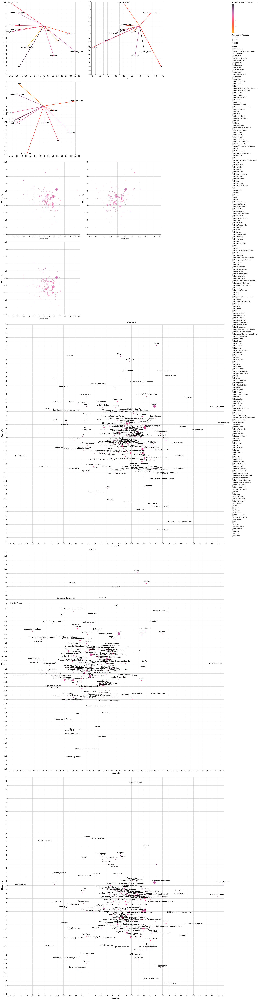

In [8]:
FEATURES_NAMES=['ARI', 'shortwords_prop' , 'longwords_prop' , 'dictwords_prop', 'sttr', 'negation_prop1', 'subjectivity_prop1', 'verb_prop','noun_prop','cconj_prop','adj_prop','adv_prop', "sttr"]



with open('vector_data.json', 'r') as f:
    values=json.load(f)

    
lines1=generate_line(values, FEATURES_NAMES, "x", "y", "z")
lines2=generate_line(values, FEATURES_NAMES, "z", "y", "x")
lines3=generate_line(values, FEATURES_NAMES, "x", "z", "y")

new1={
    "hconcat":[
        {"vconcat":[lines1,lines3]},
        lines2
        ]
    }

with open("reg_dim_data.json", "r") as f:
    values=json.load(f)



histogram1=generate_mean_scatterplot(values, "x", "y", "z", 500)
histogram2=generate_mean_scatterplot(values, "z", "y", "x", 500)
histogram3=generate_mean_scatterplot(values, "x", "z", "y", 500)


new2={
    "hconcat":[
        {"vconcat":[histogram1,histogram3]},
        histogram2
        ]
    }


with open("reg_dim_data.json", "r") as f:
    values=json.load(f)


histogram1=generate_scatterplot_with_text(values, "x", "y", "z", 1500)
histogram2=generate_scatterplot_with_text(values, "z", "y", "x", 1500)
histogram3=generate_scatterplot_with_text(values, "x", "z", "y", 1500)


new3={
    "vconcat":
    [histogram1,histogram2,histogram3]
}





new={"vconcat":[new1,new2,new3]}



VegaLite(new)

